<a href="https://colab.research.google.com/github/LOOGINF/Style_transfer/blob/main/Style_transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import array_to_img
from keras.preprocessing import image
import numpy as np
from keras.applications.vgg19 import preprocess_input
from keras.applications.vgg19 import VGG19
from keras.models import Sequential
from keras import backend as K
import keras
from keras.models import Model
import tensorflow as tf
#tf.compat.v1.disable_eager_execution()
from scipy.optimize import fmin_l_bfgs_b
from PIL import Image
from keras.layers import Input
from keras.layers.convolutional import Conv2D
from keras.layers.pooling import MaxPooling2D
from keras.layers import Dropout
from keras.layers import UpSampling2D
from keras.layers import concatenate
import tensorflow_datasets as tfds
from matplotlib import pyplot as plt

In [ ]:
# load the dataset
dataset, info = tfds.load('oxford_iiit_pet:3.2.0', with_info=True)

In [ ]:
# data information
print(info)

tfds.core.DatasetInfo(
    name='oxford_iiit_pet',
    version=3.2.0,
    description='The Oxford-IIIT pet dataset is a 37 category pet image dataset with roughly 200
images for each class. The images have large variations in scale, pose and
lighting. All images have an associated ground truth annotation of breed.',
    homepage='http://www.robots.ox.ac.uk/~vgg/data/pets/',
    features=FeaturesDict({
        'file_name': Text(shape=(), dtype=tf.string),
        'image': Image(shape=(None, None, 3), dtype=tf.uint8),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=37),
        'segmentation_mask': Image(shape=(None, None, 1), dtype=tf.uint8),
        'species': ClassLabel(shape=(), dtype=tf.int64, num_classes=2),
    }),
    total_num_examples=7349,
    splits={
        'test': 3669,
        'train': 3680,
    },
    supervised_keys=('image', 'label'),
    citation="""@InProceedings{parkhi12a,
      author       = "Parkhi, O. M. and Vedaldi, A. and Zisserman, A. and Ja

In [ ]:
# helper function (borrowed from https://www.tensorflow.org/tutorials/images/segmentation) 
def img_preprocess(image,mask):
    image = tf.cast(image, tf.float32)/255.0
    mask -= 1
    # transfer 3 labels into two labels
    return image, tf.minimum(mask,1) # modified

def load_image(datapoint):
    image = tf.image.resize(datapoint['image'], (224,224))
    mask = tf.image.resize(datapoint['segmentation_mask'], (224,224))
    image, mask = img_preprocess(image, mask)
    return image, mask

def generate_mask(pred_mask):
    pred_mask = np.squeeze(pred_mask>0.5) # modified
    pred_mask = pred_mask[...,tf.newaxis]
    return pred_mask[0]

def display(display_list):
    plt.figure(figsize=(15, 15))
    title = ['Input Image', 'True Mask', 'Predicted Mask']
    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

def display_pred(dataset, num=1):
    for image, mask in dataset.take(num):
        pred_mask = unet.predict(image)
        display([image[0], mask[0], generate_mask(pred_mask)])
        print(image.shape, pred_mask.shape)


In [ ]:
batch_size = 16
# shuffle the training set to avoid overfitting
training_data = dataset['train'].map(load_image)
training_set = training_data.shuffle(batch_size*10).batch(batch_size)
test_set = dataset['test'].map(load_image).batch(batch_size)

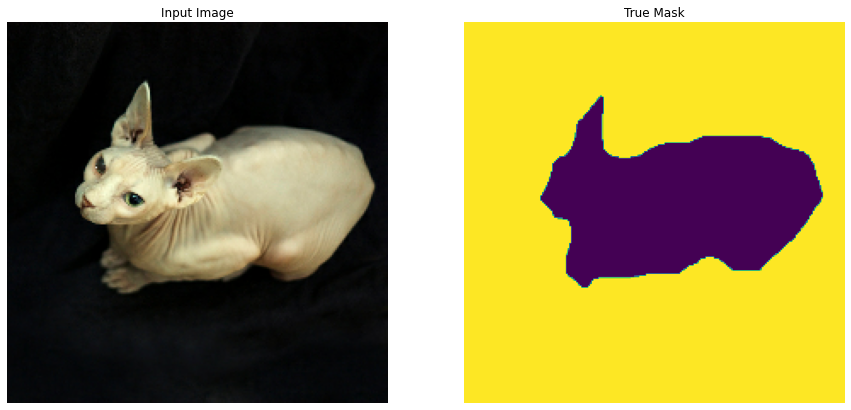

In [ ]:
tf.compat.v1.enable_eager_execution()
# dataset after transfering mask with 3 labels into mask with 2 labels
for image,mask in training_data.take(1):
    sample_image, sample_mask = image, mask
    display([sample_image, sample_mask])

In [ ]:
# use Unet for segmentation
def Unet(input_size):
    inputs = Input(input_size)
    # down
    conv1 = Conv2D(64,3, activation='relu',padding='same',kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv1)
    down1 = MaxPooling2D(pool_size=(2,2))(conv1)
    
    conv2 = Conv2D(128,3, activation='relu',padding='same',kernel_initializer='he_normal')(down1)
    conv2 = Conv2D(128,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv2)
    down2 = MaxPooling2D(pool_size=(2,2))(conv2)
    
    conv3 = Conv2D(256,3, activation='relu',padding='same',kernel_initializer='he_normal')(down2)
    conv3 = Conv2D(256,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv3)
    down3 = MaxPooling2D(pool_size=(2,2))(conv3)
    
    conv4 = Conv2D(512,3, activation='relu',padding='same',kernel_initializer='he_normal')(down3)
    conv4 = Conv2D(512,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv4)
    down4 = MaxPooling2D(pool_size=(2,2))(conv4)
    
    conv5 = Conv2D(1024,3, activation='relu',padding='same',kernel_initializer='he_normal')(down4)
    conv5 = Conv2D(1024,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv5)
    
    # up
    up1 = UpSampling2D(size=(2,2))(conv5)
    up1 = Conv2D(512,2, activation='relu',padding='same',kernel_initializer='he_normal')(up1)
    up1 = concatenate([conv4,up1],axis=3)
    conv6 = Conv2D(512,3, activation='relu',padding='same',kernel_initializer='he_normal')(up1)
    conv6 = Conv2D(512,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv6)
    
    up2 = UpSampling2D(size=(2,2))(conv6)
    up2 = Conv2D(256,2, activation='relu',padding='same',kernel_initializer='he_normal')(up2)
    up2 = concatenate([conv3,up2],axis=3)
    conv7 = Conv2D(256,3, activation='relu',padding='same',kernel_initializer='he_normal')(up2)
    conv7 = Conv2D(256,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv7)
    
    up3 = UpSampling2D(size=(2,2))(conv7)
    up3 = Conv2D(128,2, activation='relu',padding='same',kernel_initializer='he_normal')(up3)
    up3 = concatenate([conv2,up3],axis=3)
    conv8 = Conv2D(128,3, activation='relu',padding='same',kernel_initializer='he_normal')(up3)
    conv8 = Conv2D(128,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv8)
    
    up4 = UpSampling2D(size=(2,2))(conv8)
    up4 = Conv2D(64,2, activation='relu',padding='same',kernel_initializer='he_normal')(up4)
    up4 = concatenate([conv1,up4],axis=3)
    conv9 = Conv2D(64,3, activation='relu',padding='same',kernel_initializer='he_normal')(up4)
    conv9 = Conv2D(64,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv9)
    
    conv10 = Conv2D(2,3, activation='relu',padding='same',kernel_initializer='he_normal')(conv9)
    
    output = Conv2D(1,1,activation='sigmoid')(conv10)
    model = Model(inputs = inputs, outputs= output)
    return model

In [ ]:
unet = Unet((224,224,3))
# use binary_cross_entropy as loss function
unet.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])
model_history = unet.fit(
      training_set,
      epochs=15,
      validation_data=test_set,
      callbacks=[]
 )

Epoch 1/15
230/230 [==============================] - 251s 1s/step - loss: 8.2343 - accuracy: 0.6988 - val_loss: 0.4672 - val_accuracy: 0.7001
Epoch 2/15
230/230 [==============================] - 250s 1s/step - loss: 0.4348 - accuracy: 0.7921 - val_loss: 0.4050 - val_accuracy: 0.8224
Epoch 3/15
230/230 [==============================] - 250s 1s/step - loss: 0.3978 - accuracy: 0.8319 - val_loss: 0.3979 - val_accuracy: 0.8352
Epoch 4/15
230/230 [==============================] - 250s 1s/step - loss: 0.3662 - accuracy: 0.8522 - val_loss: 0.3499 - val_accuracy: 0.8608
Epoch 5/15
230/230 [==============================] - 250s 1s/step - loss: 0.3363 - accuracy: 0.8659 - val_loss: 0.3151 - val_accuracy: 0.8792
Epoch 6/15
230/230 [==============================] - 251s 1s/step - loss: 0.3142 - accuracy: 0.8767 - val_loss: 0.3172 - val_accuracy: 0.8758
Epoch 7/15
230/230 [==============================] - 250s 1s/step - loss: 0.2832 - accuracy: 0.8907 - val_loss: 0.2771 - val_accuracy: 0.8913

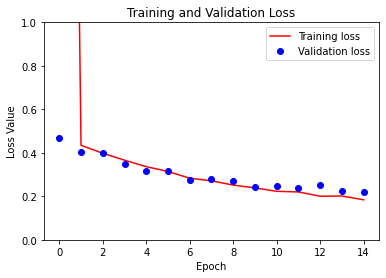

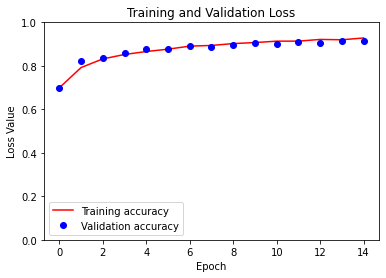

In [ ]:
loss = model_history.history['loss']
val_loss = model_history.history['val_loss']

epochs = range(15)

plt.figure()
plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'bo', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 1])
plt.legend()
plt.show()

plt.figure()
plt.plot(epochs, model_history.history['accuracy'], 'r', label='Training accuracy')
plt.plot(epochs, model_history.history['val_accuracy'], 'bo', label='Validation accuracy')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.ylim([0, 1])
plt.legend()
plt.show()

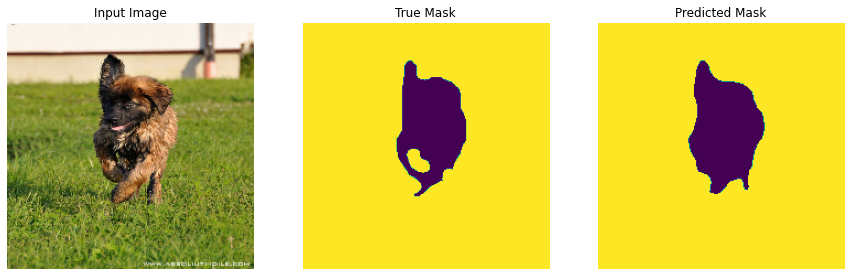

(16, 224, 224, 3) (16, 224, 224, 1)


In [ ]:
# prediction on the test set
display_pred(test_set, 1)

In [ ]:
# the predicted mask can cover the major area of the pet, we will save the model with 15 epochs
unet.save("img_seg_model.h5")

In [ ]:
unet = keras.models.load_model("img_seg_model.h5")

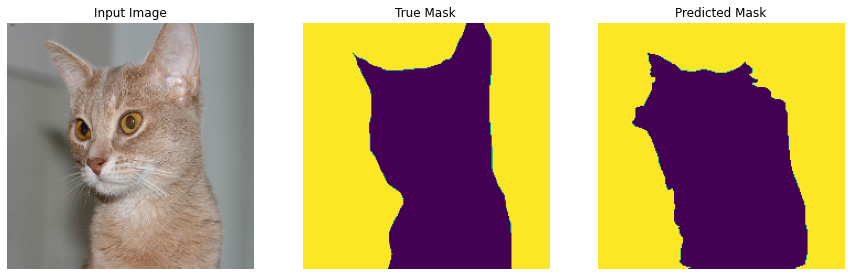

In [ ]:
# we will randomly pick one pet image from the test set as our content image for style transfer
for image, mask in test_set.take(1):
  pred_mask = unet.predict(image)
  created_mask = generate_mask(pred_mask)
  display([image[0], mask[0], created_mask])
content_img = array_to_img(image[0])
content_img.save("content.jpg")
mask_img = array_to_img(created_mask)
mask_img.save("segm.jpg")

In [ ]:
# image preprocessing and deprocessing (borrowed from https://keras.io/examples/generative/neural_style_transfer/)
def img_preprocessing(img_dir, img_name):
    img_file = img_dir + img_name
    img = load_img(img_file, target_size=config['target_size'])
    img_array = img_to_array(img)
    x = np.expand_dims(img_array,axis=0)
    x = preprocess_input(x)
    return x

def deprocess_image(x):
    x = x.reshape((config['scaled_height'], scaled_width, 3))
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype("uint8")
    return x

# According to 'Image Style Transfer Using Convolutional Neural Networks', replace max pooling by avg pooling
def avg_pooling_vgg(shape):
    # pretrained vgg19
    vgg = VGG19(include_top=False,weights= 'imagenet', input_shape=shape)
    avgpoolVgg = Sequential()
    for i in vgg.layers:
        # if the current layer is maxPooling, then replace it with avgpooling
        if i.name.endswith('pool'):
            avgpoolVgg.add(keras.layers.AveragePooling2D())
        else:
            avgpoolVgg.add(i)
    return avgpoolVgg

# compute content loss
def contentloss(F,P):
    loss = K.sum(K.square(F-P))/ 2
    return loss

# compute style loss
def gram(F):
    # input F: [ch,h,w], transform to [ ch,h * w] * [h * w,ch]
    features = K.batch_flatten(K.permute_dimensions(F, (2, 0, 1)))
    gram = K.dot(features, K.transpose(features))
    return gram
 
def styleloss(x,a):
    # N = 3, M = width * height
    loss = K.sum(K.square(gram(x) - gram(a))) / (4 * (3 ** 2) * (scaled_size ** 2))
    return loss

In [ ]:
config = {'content_dir': './',
          'content_img': 'content.jpg',
          'style_dir': './',
          'style1_img': 'style1.jpg',
          'style2_img': 'style2.jpg',
          'mask_img': 'segm.jpg',
          'target_size': (224,224),
          'scaled_height':224,
          'content_CNN_layer': 4,
          'style1_layers': [i for i in range(16)],
          'style2_layers': [i for i in range(16)],
          'content_weight': 1,
          'style1_weight': 15,
          'style2_weight': 1,
          'epoch': 15
}

In [ ]:
# load images
content = img_preprocessing(config['content_dir'],config['content_img'])
style1 = img_preprocessing(config['style_dir'],config['style1_img'])
style2 = img_preprocessing(config['style_dir'],config['style2_img'])
mask = img_to_array(load_img(config['content_dir'] + config['mask_img'], target_size=(224,224)))
width, height = load_img(config['content_dir'] + config['content_img']).size
# dimension of the generated picture

scaled_width = 224
scaled_size = scaled_width * config['scaled_height']
white_noise = K.placeholder((1, 224, 224, 3))
mask_key = (mask>0)*1.0
mask_background = (mask == 0) * 1.0
inputs = K.concatenate([content,style1,style2,white_noise*mask_key,white_noise*mask_background],axis=0)

(-0.5, 223.5, 223.5, -0.5)

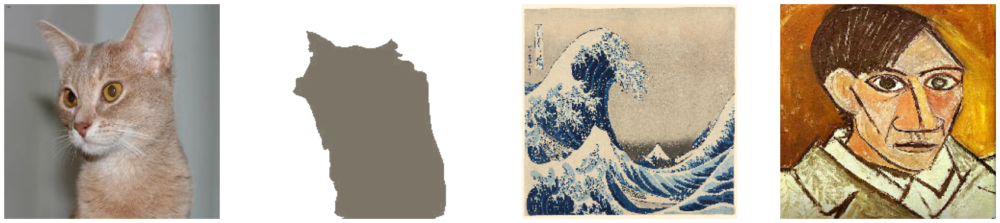

In [ ]:
# display content, mask and styles  images
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(30, 10))
ax1.imshow(deprocess_image(content))
ax1.axis("off")
ax2.imshow(deprocess_image(mask))
ax2.axis("off")
ax3.imshow(deprocess_image(style1))
ax3.axis("off")
ax4.imshow(deprocess_image(style2))
ax4.axis("off")
# ax5.imshow(deprocess_image(target))
# ax5.axis("off")

In [ ]:
avg_vgg = avg_pooling_vgg(shape=(224,224,3))
outputs = {layer.name:layer.output for layer in avg_vgg.layers}
model = Model(inputs=avg_vgg.inputs, outputs=outputs)(inputs)
# cnn layers from vg199
cnn_layers = [i.name for i in avg_vgg.layers if 'conv' in i.name]

In [ ]:
total_loss = 0
# content loss
content_feature = model[cnn_layers[config['content_CNN_layer']]][0,:,:,:]
white_noise_feature = model[cnn_layers[config['content_CNN_layer']]][3,:,:,:] + model[cnn_layers[config['content_CNN_layer']]][4,:,:,:]
total_loss = total_loss + contentloss(white_noise_feature,content_feature) * config['content_weight']

# style1 loss
style1_loss = 0
# average weight for each layer
style1_layer_weight = 1 / len(config['style1_layers'])
for layers in config['style1_layers']:
    style1_feature = model[cnn_layers[layers]][1,:,:,:]
    white_noise_feature = model[cnn_layers[layers]][3,:,:,:]
    style1_loss = style1_loss + styleloss(white_noise_feature,style1_feature) * style1_layer_weight
total_loss = total_loss + style1_loss * config['style1_weight']

# style2 loss
style2_loss = 0
style2_layer_weight = 1 / len(config['style2_layers'])
for layers in config['style2_layers']:
    style2_feature = model[cnn_layers[layers]][2,:,:,:]
    white_noise_feature = model[cnn_layers[layers]][4,:,:,:]
    style2_loss = style2_loss + styleloss(white_noise_feature,style2_feature) * style2_layer_weight
total_loss = total_loss + style2_loss * config['style2_weight']

In [ ]:
# use L-BFGS optimizer
tf.compat.v1.disable_eager_execution()
grads = K.gradients(total_loss,white_noise)[0]
loss_grad = K.function([white_noise],[total_loss,grads])

In [ ]:
# CHOOSE EPOCH

epoch: 0
loss: 144553869312.0


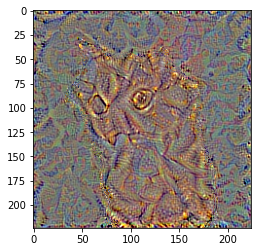

epoch: 1
loss: 75481792512.0


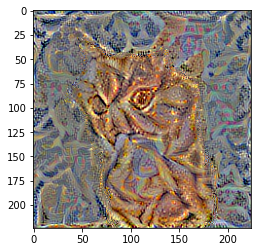

epoch: 2
loss: 62581895168.0


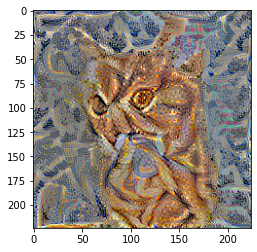

epoch: 3
loss: 56619245568.0


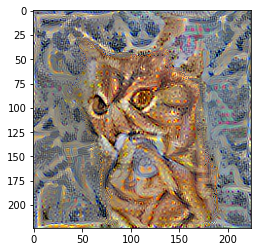

epoch: 4
loss: 53153062912.0


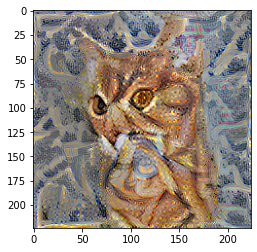

epoch: 5
loss: 51326521344.0


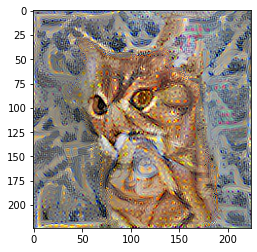

epoch: 6
loss: 49932042240.0


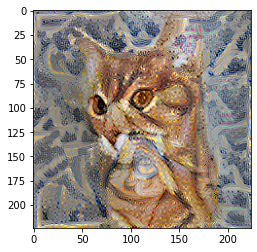

epoch: 7
loss: 49002012672.0


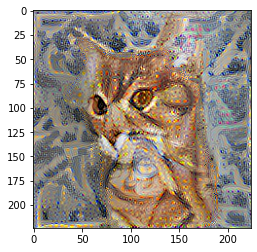

epoch: 8
loss: 48271462400.0


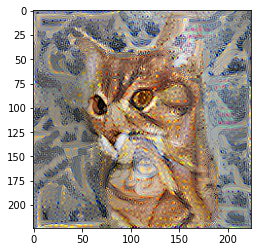

epoch: 9
loss: 47727173632.0


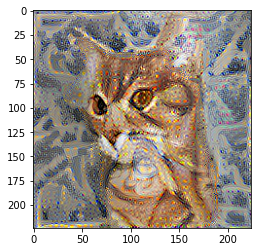

epoch: 10
loss: 47235313664.0


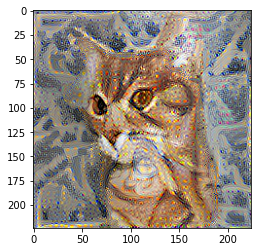

epoch: 11
loss: 46839095296.0


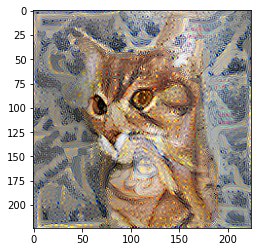

epoch: 12
loss: 46546137088.0


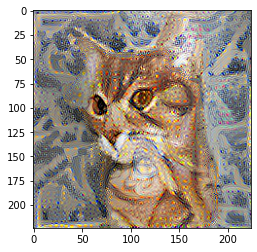

epoch: 13
loss: 46297788416.0


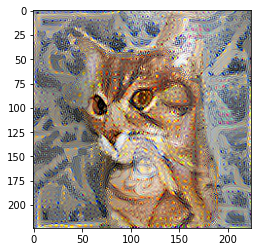

epoch: 14
loss: 46107099136.0


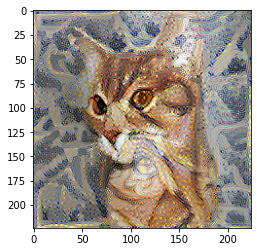

epoch: 15
loss: 45964218368.0


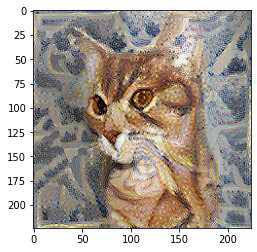

epoch: 16
loss: 45845438464.0


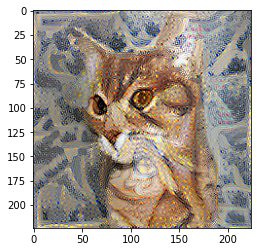

epoch: 17
loss: 45739122688.0


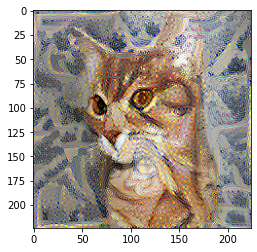

epoch: 18
loss: 45657939968.0


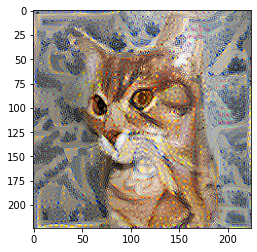

epoch: 19
loss: 45592453120.0


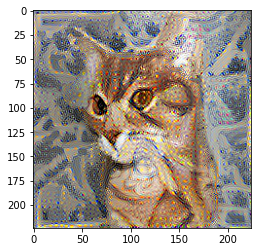

epoch: 20
loss: 45530562560.0


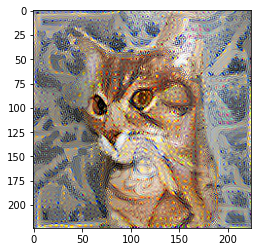

epoch: 21
loss: 45471096832.0


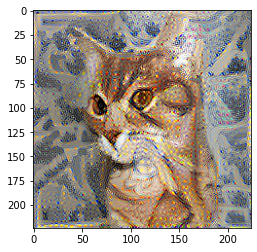

epoch: 22
loss: 45421862912.0


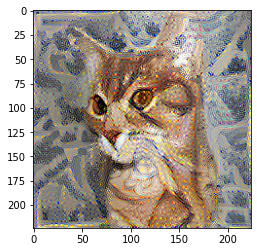

epoch: 23
loss: 45379624960.0


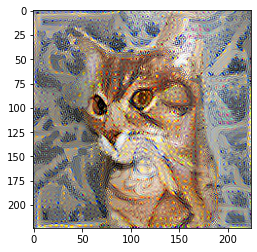

epoch: 24
loss: 45340348416.0


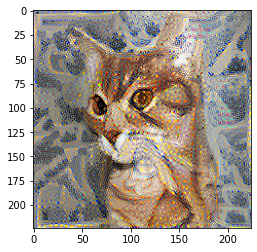

epoch: 25
loss: 45306417152.0


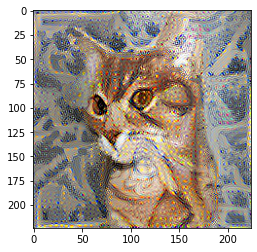

epoch: 26
loss: 45278334976.0


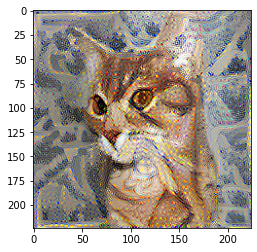

epoch: 27
loss: 45253758976.0


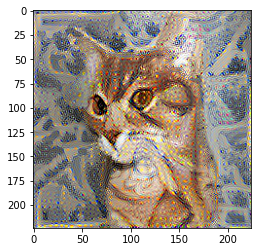

epoch: 28
loss: 45231681536.0


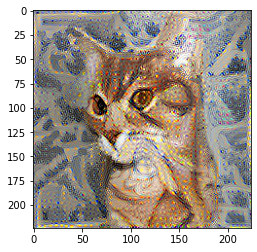

epoch: 29
loss: 45212233728.0


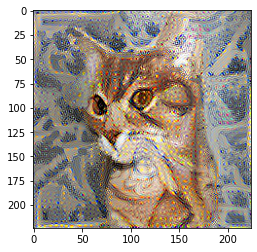

epoch: 30
loss: 45194567680.0


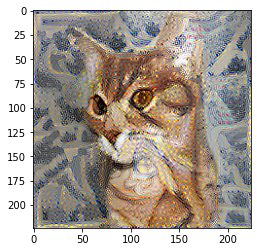

epoch: 31
loss: 45178564608.0


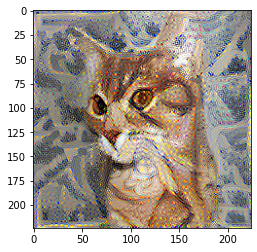

epoch: 32
loss: 45165043712.0


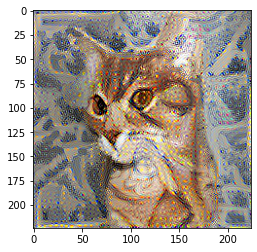

epoch: 33
loss: 45152653312.0


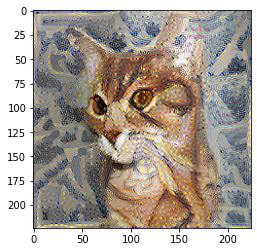

epoch: 34
loss: 45141721088.0


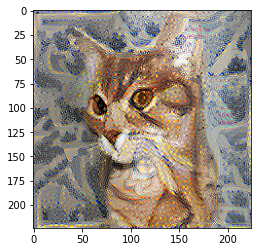

epoch: 35
loss: 45132140544.0


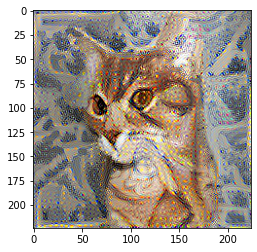

epoch: 36
loss: 45123624960.0


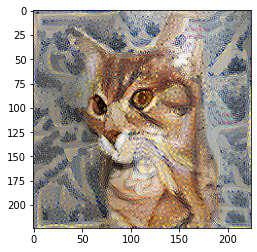

epoch: 37
loss: 45116284928.0


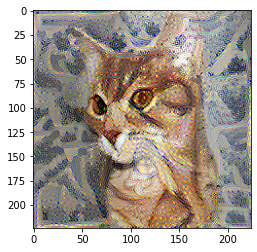

epoch: 38
loss: 45109321728.0


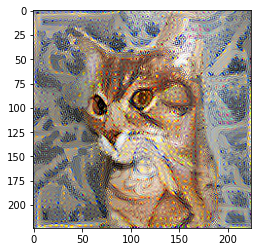

epoch: 39
loss: 45102317568.0


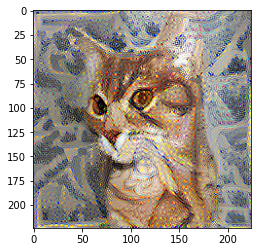

epoch: 40
loss: 45095477248.0


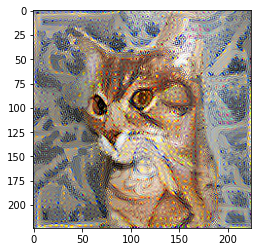

epoch: 41
loss: 45088956416.0


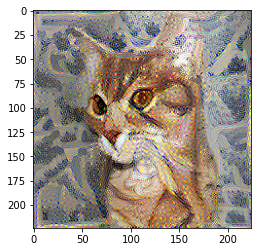

epoch: 42
loss: 45082832896.0


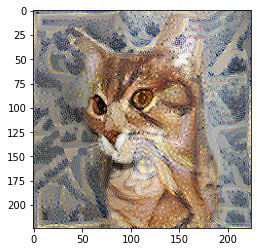

epoch: 43
loss: 45076963328.0


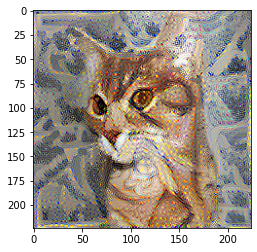

epoch: 44
loss: 45071269888.0


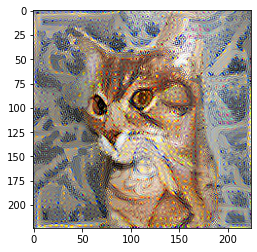

epoch: 45
loss: 45065789440.0


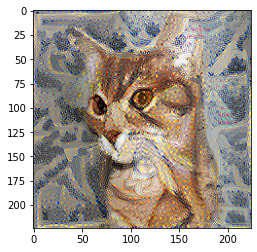

epoch: 46
loss: 45060489216.0


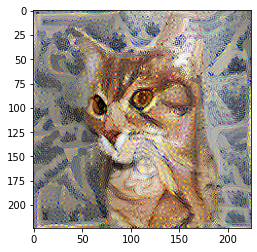

epoch: 47
loss: 45055369216.0


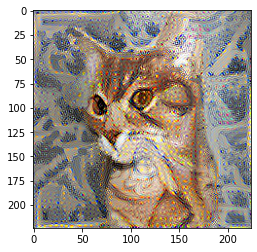

epoch: 48
loss: 45050757120.0


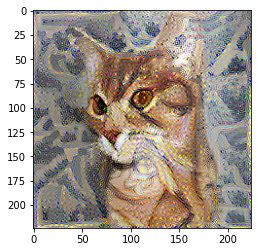

epoch: 49
loss: 45046525952.0


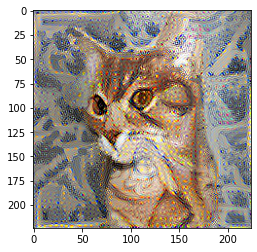

In [ ]:
# content weight = 1 style weight = 1, content cnn layer = 1, style cnn layer = 1-16, epoch = 50
# the generated pictures visually look the same after 15 epoch, so we will use epoch = 15 for other experiments
def get_loss_grad(x):
    x = x.reshape((1,224,224,3))
    loss,grad = loss_grad([x])
    return loss.astype(np.float64), grad.flatten().astype(np.float64)
x = np.random.randn(np.prod((1, 224, 224, 3)))
for i in range(config['epoch']):
    print('epoch:',i)
    x,min_val,info = fmin_l_bfgs_b(func=get_loss_grad,x0=x,maxfun=20)
    print('loss:',min_val)
    img = x.copy().reshape((224, 224, 3))
    img = deprocess_image(img)
    plt.imshow(img)
    plt.show()

In [ ]:
# CHOOSE STYLE WEIGHT

epoch: 0
loss: 1172227620864.0


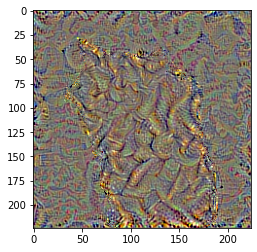

epoch: 1
loss: 377150701568.0


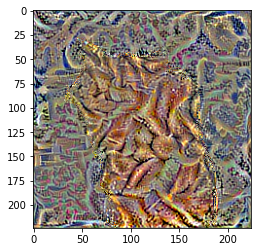

epoch: 2
loss: 252221521920.0


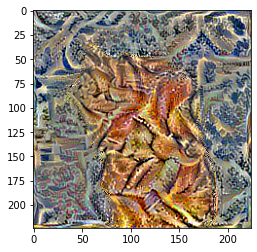

epoch: 3
loss: 203095883776.0


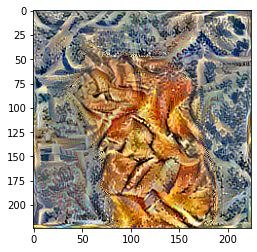

epoch: 4
loss: 182656630784.0


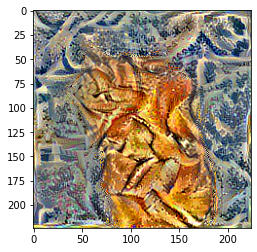

epoch: 5
loss: 172026003456.0


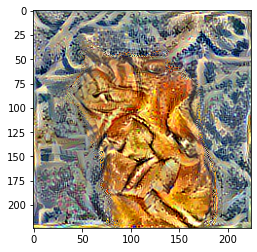

epoch: 6
loss: 163828826112.0


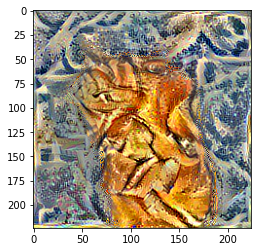

epoch: 7
loss: 158213586944.0


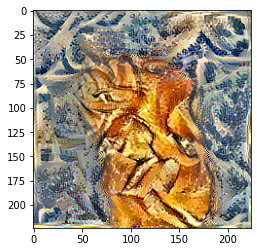

epoch: 8
loss: 153905348608.0


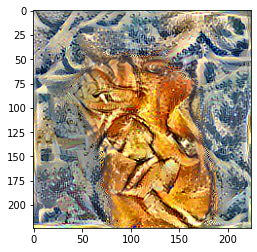

epoch: 9
loss: 150266560512.0


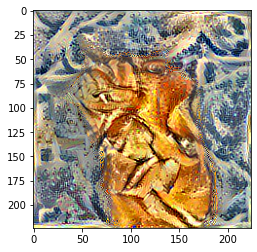

epoch: 10
loss: 147330105344.0


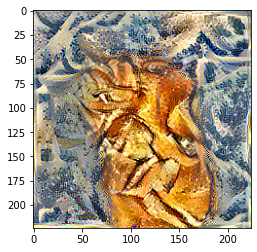

epoch: 11
loss: 144715382784.0


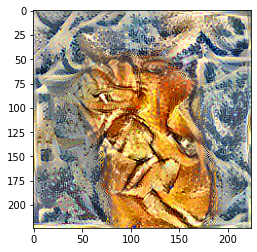

epoch: 12
loss: 142756478976.0


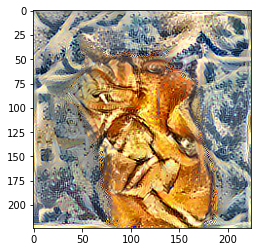

epoch: 13
loss: 140938903552.0


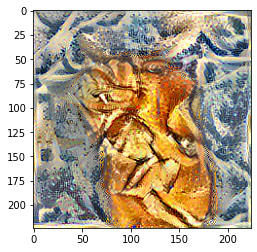

epoch: 14
loss: 139421286400.0


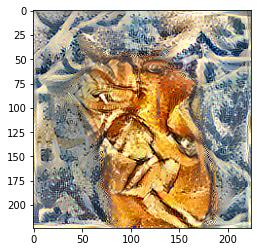

In [ ]:
# content weight = 1 style weight = 10, content cnn layer = 1, style cnn layer = 1-16, epoch = 15
# the style weight of the pet part seems to be too heavy, the background visually looks more clear compares to style weight of 1
x = np.random.randn(np.prod((1, 224, 224, 3)))
for i in range(config['epoch']):
    print('epoch:',i)
    x,min_val,info = fmin_l_bfgs_b(func=get_loss_grad,x0=x,maxfun=20)
    print('loss:',min_val)
    img = x.copy().reshape((224, 224, 3))
    img = deprocess_image(img)
    plt.imshow(img)
    plt.show()

epoch: 0
loss: 1726028447744.0


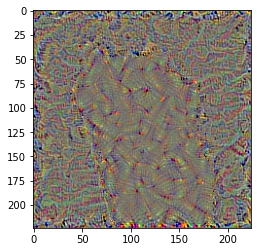

epoch: 1
loss: 392168472576.0


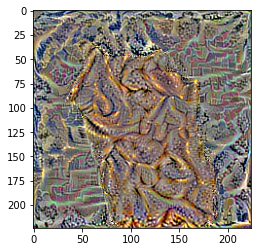

epoch: 2
loss: 262100942848.0


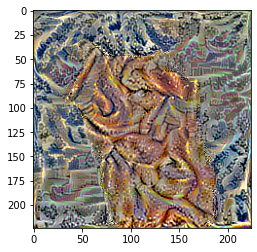

epoch: 3
loss: 209426104320.0


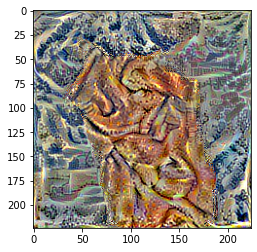

epoch: 4
loss: 181885419520.0


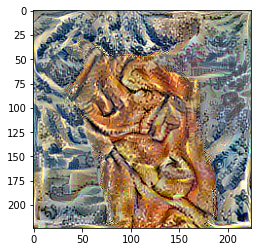

epoch: 5
loss: 166894026752.0


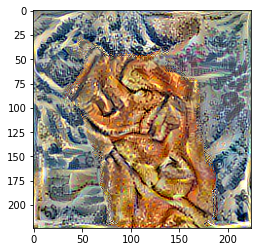

epoch: 6
loss: 155445772288.0


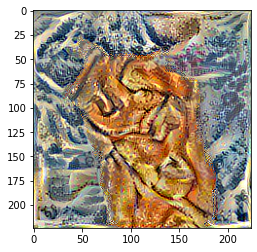

epoch: 7
loss: 147500302336.0


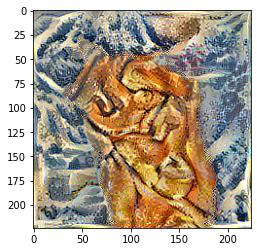

epoch: 8
loss: 141742702592.0


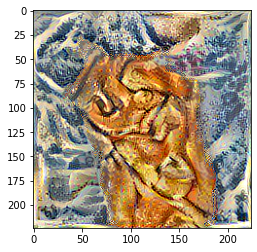

epoch: 9
loss: 137212895232.0


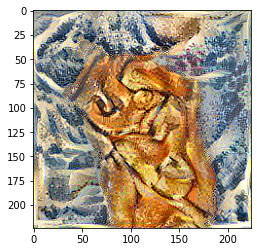

epoch: 10
loss: 133922529280.0


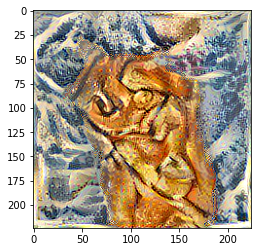

epoch: 11
loss: 131090980864.0


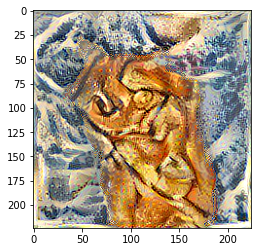

epoch: 12
loss: 129072504832.0


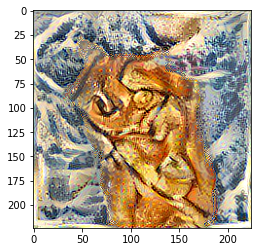

epoch: 13
loss: 127166873600.0


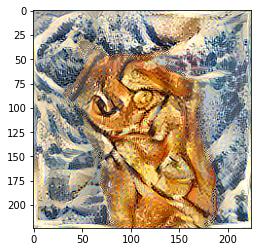

epoch: 14
loss: 125671956480.0


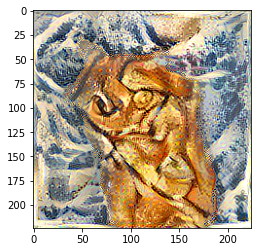

In [ ]:
# content weight = 1 style1(background) weight = 15, style2(cat) weight = 5, content cnn layer = 1, style cnn layer = 1-16, epoch = 15
# we will choose style2 weight = 1 and style1 weight = 15
x = np.random.randn(np.prod((1, 224, 224, 3)))
for i in range(config['epoch']):
    print('epoch:',i)
    x,min_val,info = fmin_l_bfgs_b(func=get_loss_grad,x0=x,maxfun=20)
    print('loss:',min_val)
    img = x.copy().reshape((224, 224, 3))
    img = deprocess_image(img)
    plt.imshow(img)
    plt.show()

In [ ]:
# CHOOSE CONTENT LAYER

epoch: 0
loss: 1229839400960.0


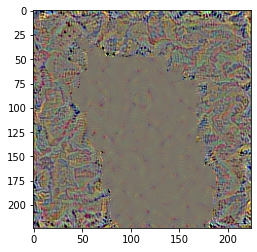

epoch: 1
loss: 274952880128.0


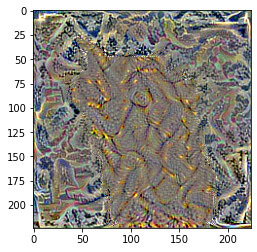

epoch: 2
loss: 186125713408.0


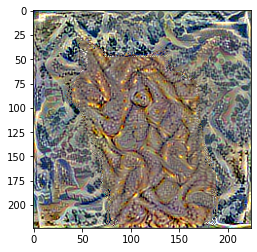

epoch: 3
loss: 155162050560.0


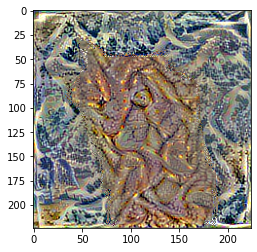

epoch: 4
loss: 137587687424.0


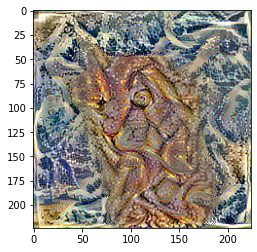

epoch: 5
loss: 125342203904.0


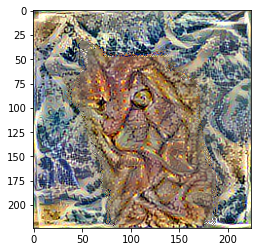

epoch: 6
loss: 116395294720.0


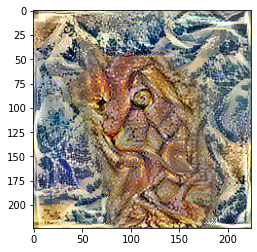

epoch: 7
loss: 109987577856.0


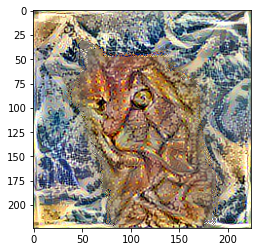

epoch: 8
loss: 103543029760.0


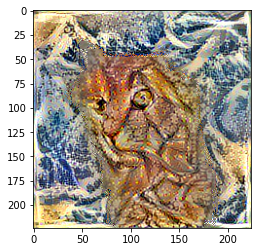

epoch: 9
loss: 99624468480.0


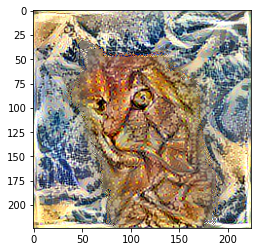

epoch: 10
loss: 96492036096.0


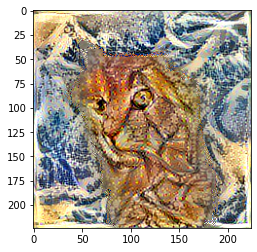

epoch: 11
loss: 93462560768.0


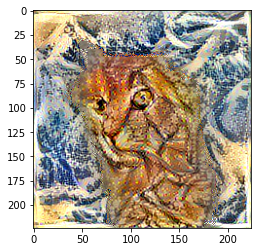

epoch: 12
loss: 91413700608.0


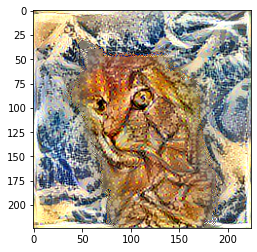

epoch: 13
loss: 89569812480.0


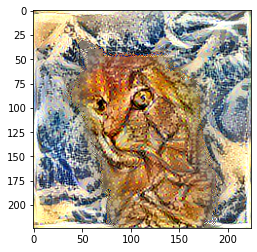

epoch: 14
loss: 88012513280.0


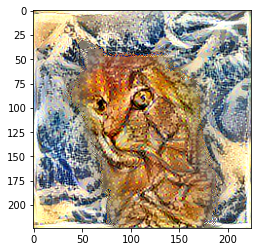

In [ ]:
# content weight = 1 style1(background) weight = 15, style2(cat) weight = 1, content cnn layer = 4, style cnn layer = 1-16, epoch = 15
# compares to content cnn layer = 1, the cat has heavier painting style. However, some features are lost (ears)
# compares to style2 weight = 5 content cnn = 1, both of them have similar painting style, while style2 weight = 1 content cnn =4 preserves more features
x = np.random.randn(np.prod((1, 224, 224, 3)))
for i in range(config['epoch']):
    print('epoch:',i)
    x,min_val,info = fmin_l_bfgs_b(func=get_loss_grad,x0=x,maxfun=20)
    print('loss:',min_val)
    img = x.copy().reshape((224, 224, 3))
    img = deprocess_image(img)
    plt.imshow(img)
    plt.show()

epoch: 0
loss: 1242958397440.0


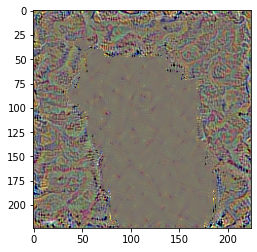

epoch: 1
loss: 289105051648.0


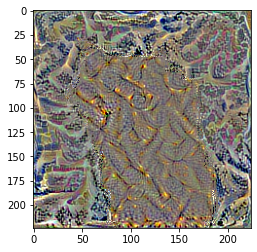

epoch: 2
loss: 196790370304.0


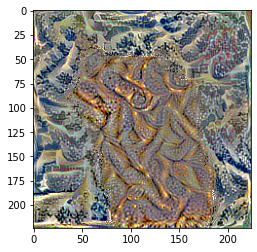

epoch: 3
loss: 163183640576.0


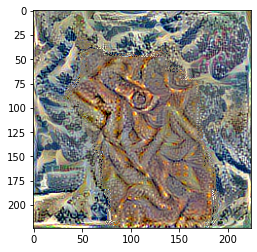

epoch: 4
loss: 148137312256.0


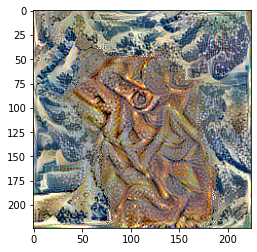

epoch: 5
loss: 137645670400.0


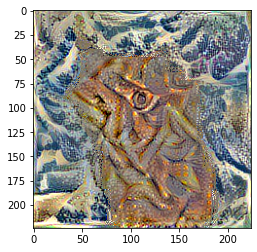

epoch: 6
loss: 129444970496.0


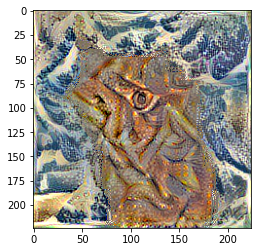

epoch: 7
loss: 123387248640.0


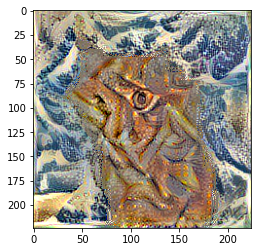

epoch: 8
loss: 118281764864.0


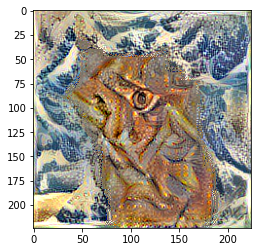

epoch: 9
loss: 114080915456.0


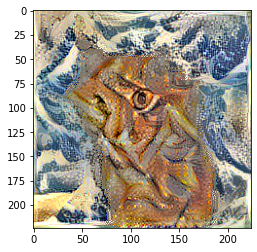

epoch: 10
loss: 111258517504.0


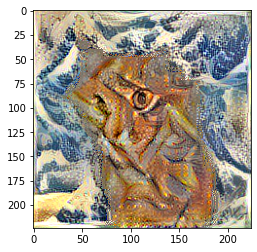

epoch: 11
loss: 108249104384.0


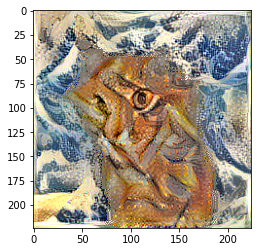

epoch: 12
loss: 106063069184.0


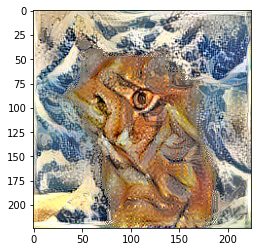

epoch: 13
loss: 104385626112.0


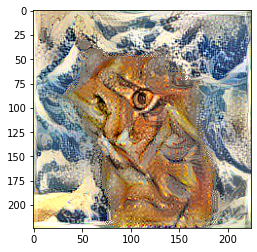

epoch: 14
loss: 103024615424.0


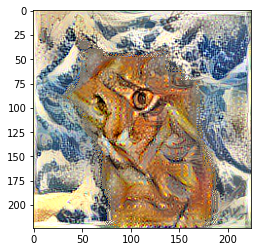

In [ ]:
# content weight = 1 style1(background) weight = 15, style2(cat) weight = 1, content cnn layer = 2, style cnn layer = 1-16, epoch = 15
# compares to content cnn layer = 4, the cat preserves more features but with less painting style
x = np.random.randn(np.prod((1, 224, 224, 3)))
for i in range(config['epoch']):
    print('epoch:',i)
    x,min_val,info = fmin_l_bfgs_b(func=get_loss_grad,x0=x,maxfun=20)
    print('loss:',min_val)
    img = x.copy().reshape((224, 224, 3))
    img = deprocess_image(img)
    plt.imshow(img)
    plt.show()

epoch: 0
loss: 1124999888896.0


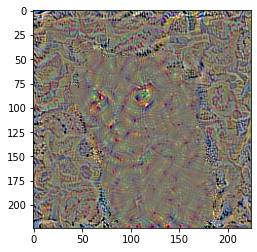

epoch: 1
loss: 547967893504.0


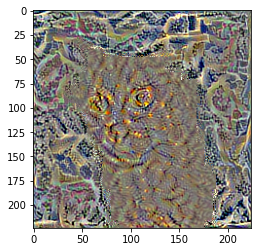

epoch: 2
loss: 458346889216.0


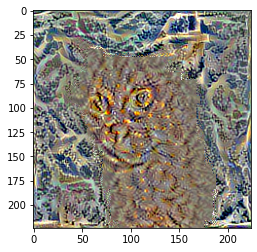

epoch: 3
loss: 420786864128.0


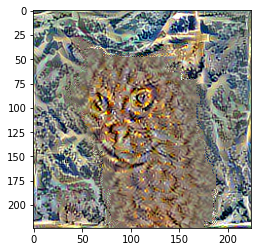

epoch: 4
loss: 400648110080.0


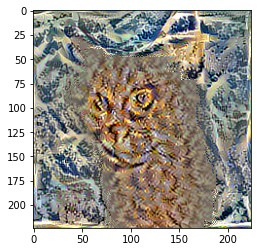

epoch: 5
loss: 387322740736.0


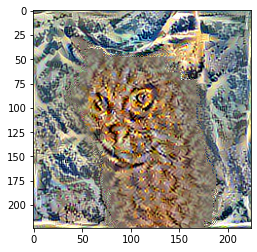

epoch: 6
loss: 378044743680.0


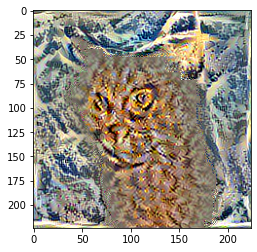

epoch: 7
loss: 371345391616.0


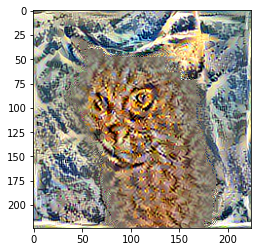

epoch: 8
loss: 365840793600.0


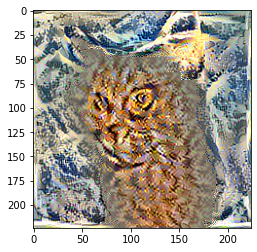

epoch: 9
loss: 360811397120.0


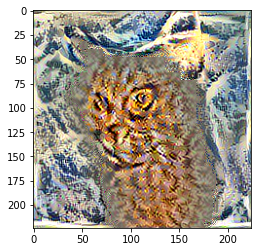

epoch: 10
loss: 357103665152.0


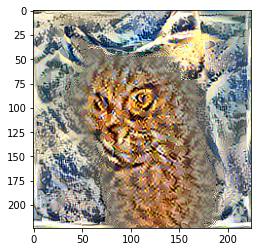

epoch: 11
loss: 354014363648.0


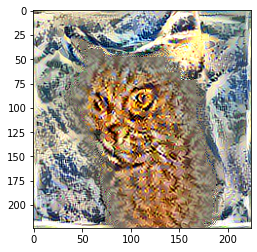

epoch: 12
loss: 351527075840.0


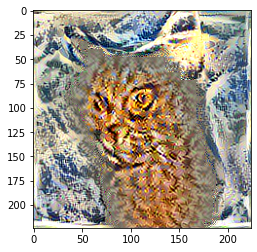

epoch: 13
loss: 349645275136.0


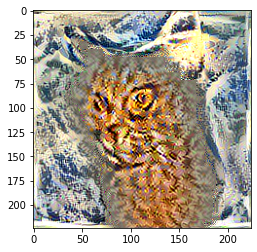

epoch: 14
loss: 348142141440.0


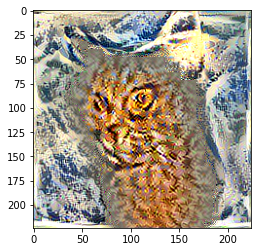

In [ ]:
# content weight = 1 style1(background) weight = 15, style2(cat) weight = 1, content cnn layer = 8, style cnn layer = 1-16, epoch = 15
# compares to content cnn layer = 4, preserves less features and becomes unclear as well as more shadow, we will select content cnn layer = 4
x = np.random.randn(np.prod((1, 224, 224, 3)))
for i in range(config['epoch']):
    print('epoch:',i)
    x,min_val,info = fmin_l_bfgs_b(func=get_loss_grad,x0=x,maxfun=20)
    print('loss:',min_val)
    img = x.copy().reshape((224, 224, 3))
    img = deprocess_image(img)
    plt.imshow(img)
    plt.show()

In [ ]:
# CHOOSE STYLE CNN LAYER

epoch: 0
loss: 1684724514816.0


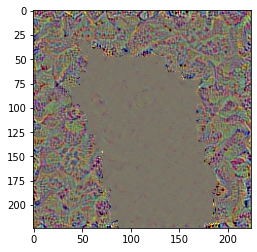

epoch: 1
loss: 330485858304.0


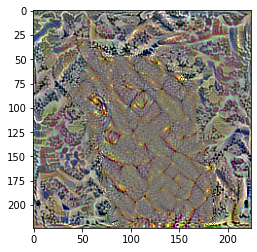

epoch: 2
loss: 190350852096.0


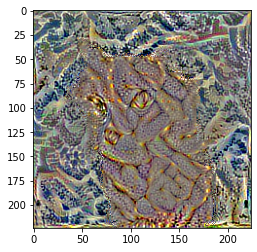

epoch: 3
loss: 143324659712.0


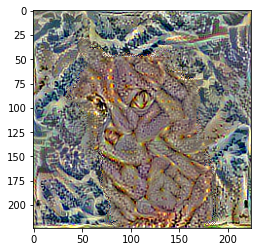

epoch: 4
loss: 124329000960.0


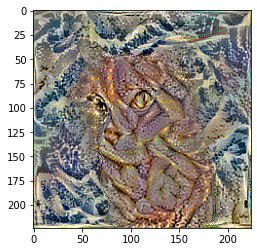

epoch: 5
loss: 113852211200.0


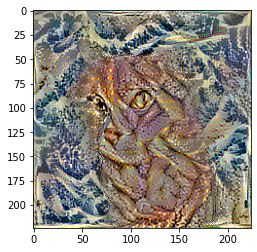

epoch: 6
loss: 108317245440.0


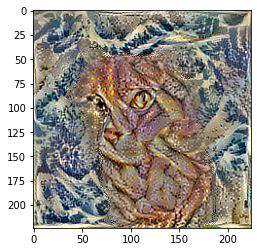

epoch: 7
loss: 103534714880.0


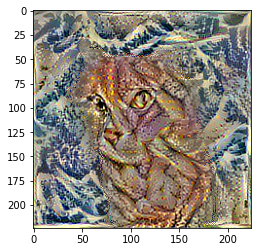

epoch: 8
loss: 100402282496.0


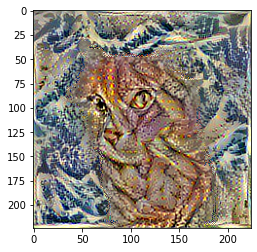

epoch: 9
loss: 97279188992.0


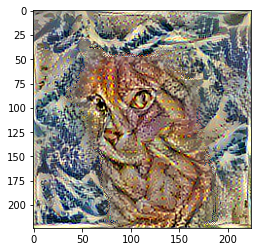

epoch: 10
loss: 95171346432.0


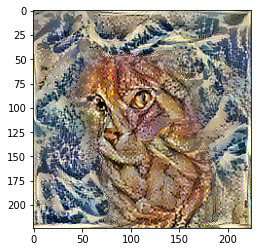

epoch: 11
loss: 93314359296.0


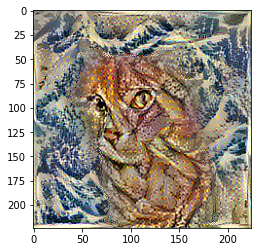

epoch: 12
loss: 91817713664.0


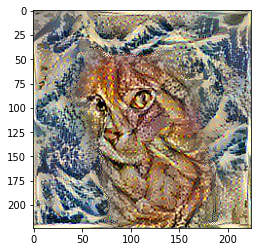

epoch: 13
loss: 90658004992.0


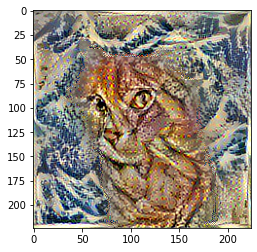

epoch: 14
loss: 89700311040.0


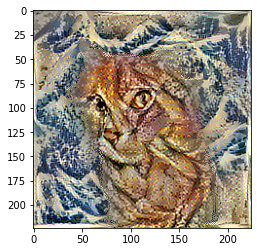

In [ ]:
# content weight = 1 style1(background) weight = 15, style2(cat) weight = 1, content cnn layer = 4, style cnn layer = [2,4,6,8], epoch = 15
# compares to style cnn layer = 1-16, both the background and cat visually look darker
x = np.random.randn(np.prod((1, 224, 224, 3)))
for i in range(config['epoch']):
    print('epoch:',i)
    x,min_val,info = fmin_l_bfgs_b(func=get_loss_grad,x0=x,maxfun=20)
    print('loss:',min_val)
    img = x.copy().reshape((224, 224, 3))
    img = deprocess_image(img)
    plt.imshow(img)
    plt.show()

epoch: 0
loss: 2956042698752.0


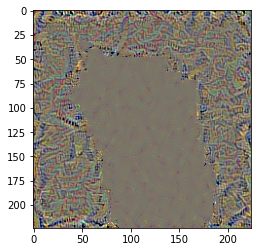

epoch: 1
loss: 451887661056.0


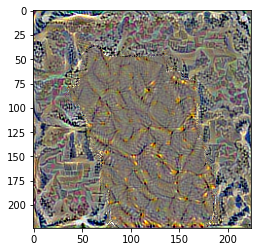

epoch: 2
loss: 221322805248.0


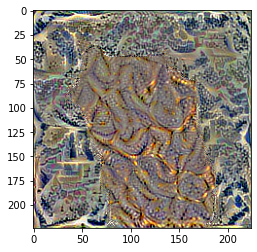

epoch: 3
loss: 163806085120.0


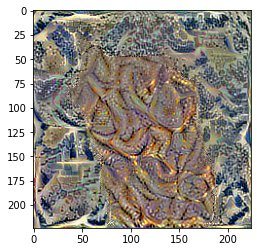

epoch: 4
loss: 139327389696.0


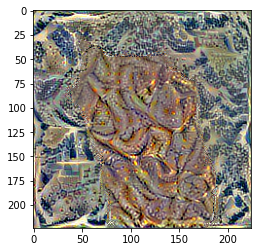

epoch: 5
loss: 125680009216.0


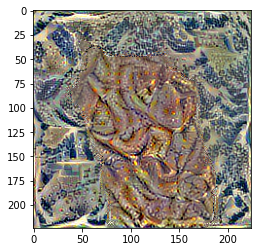

epoch: 6
loss: 117080662016.0


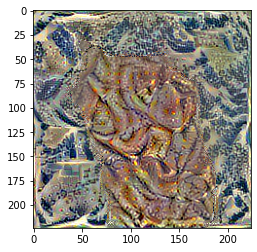

epoch: 7
loss: 111076130816.0


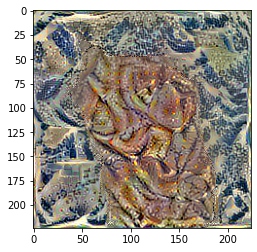

epoch: 8
loss: 107125915648.0


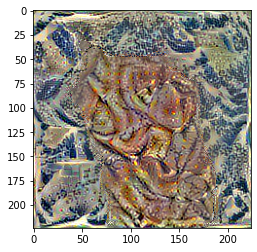

epoch: 9
loss: 103473373184.0


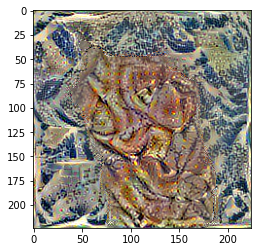

epoch: 10
loss: 100896874496.0


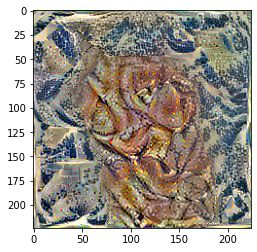

epoch: 11
loss: 98499731456.0


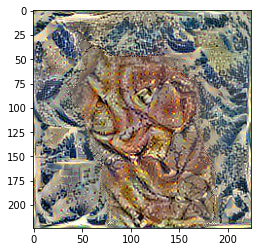

epoch: 12
loss: 96678043648.0


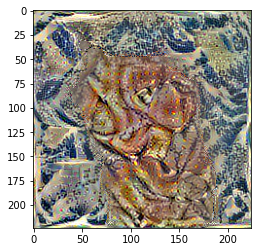

epoch: 13
loss: 95154577408.0


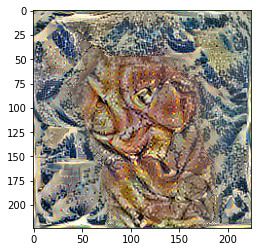

epoch: 14
loss: 93920575488.0


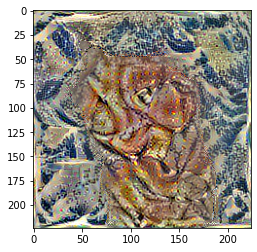

In [ ]:
# content weight = 1 style1(background) weight = 15, style2(cat) weight = 1, content cnn layer = 4, style cnn layer = [3,7,10,13], epoch = 15
# compares to style cnn layer =[2,4,6,8], the features of cat are not preserved. Different choice of layers will effect the style significantly. 
# However, it's hard to tell the exact effect of the choice of style layers as there could be lots of combinations.
x = np.random.randn(np.prod((1, 224, 224, 3)))
for i in range(config['epoch']):
    print('epoch:',i)
    x,min_val,info = fmin_l_bfgs_b(func=get_loss_grad,x0=x,maxfun=20)
    print('loss:',min_val)
    img = x.copy().reshape((224, 224, 3))
    img = deprocess_image(img)
    plt.imshow(img)
    plt.show()